## Assuming autocorrelation in experiences

Extending:
Denrell, Jerker. 2005. “Why Most People Disapprove of Me : Experience Sampling in Impression Formation.” Psychological Review 112(4):951–78.

October 2017

In [1]:
%pylab inline
import numpy as np
from scipy.stats import gaussian_kde

Populating the interactive namespace from numpy and matplotlib


In [2]:
weight = .1  
baseline = 0  
sensitivity = 3  

def p_interact(
        belief, 
        weight=.1,  # called 'b'
        baseline=0,  # called 'c'
        sensitivity=3, # called 'S'
        forcing=0,  # called 'r'
    ):
    return (forcing + (1-forcing) *
            np.exp(baseline + sensitivity * belief) / 
            (1 + np.exp(baseline + sensitivity * belief)))

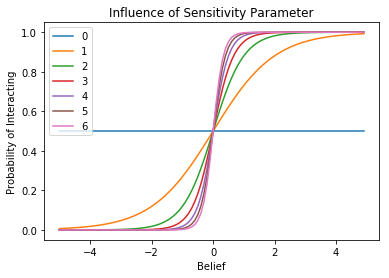

In [3]:
x = np.arange(-5,5,.1)

for S in range(7):
    p = np.vectorize(p_interact)(x, sensitivity=S)
    plt.plot(x, p)
plt.xlabel('Belief')
plt.ylabel('Probability of Interacting')
plt.legend(range(7))
plt.title('Influence of Sensitivity Parameter');

In [12]:
def sim(weight=.1,  # called 'b'
        baseline=0,  # called 'c',
        sensitivity=3,  # called 'S'
        forcing=0,  # called 'r'
        steps=10,
        corr_weight = .9,
    ):
    beliefs = [0]
    observations = []
    for t in range(steps):
        old_belief = beliefs[-1]
        p=p_interact(old_belief, weight, baseline, sensitivity, forcing)
        interact = np.random.binomial(1, p)
        if interact==1 or t==0:
            if t > 0:
                last_obs = observations[-1]
                observation = corr_weight*last_obs + (1-corr_weight)*np.random.normal(loc=0, scale=1)
            else:
                observation = np.random.normal(loc=0, scale=1)
            observations.append(observation)
            new_belief = (1-weight)*old_belief + weight*observation
            beliefs.append(new_belief)
        else:
            beliefs.append(old_belief)
            
    return beliefs

# Sensitivity = 3

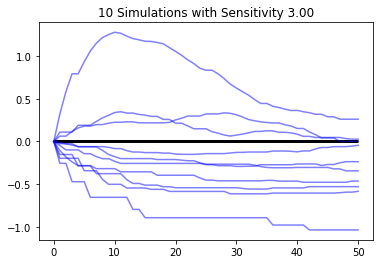

In [13]:
n_sims = 10
S = 3
ends = []
for _ in range(n_sims):
    res = sim(steps=50, sensitivity=S)
    plt.plot(res, 'b', alpha=.5)
plt.title('%i Simulations with Sensitivity %.02f' % (n_sims, S))
plt.hlines(0, 0, 50, 'k', linewidth=3, alpha=1);

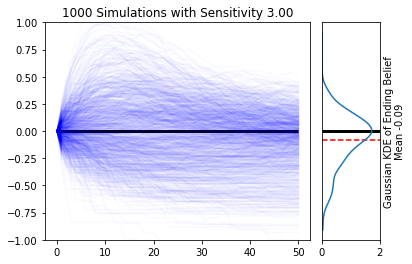

In [23]:
n_sims = 1000
S = 3
ends = []
plt.subplot2grid((1,5), (0,0), 1, 4)
collector = []
for _ in range(n_sims):
    res = sim(steps=50, sensitivity=S)
    collector.append(ends)
    ends.append(res[-1])
    plt.plot(res, 'b', alpha=.02)
plt.title('%i Simulations with Sensitivity %.02f' % (n_sims, S))
plt.hlines(0, 0, 50, 'k', linewidth=3, alpha=1)
plt.ylim(-1, 1)

ax = plt.subplot2grid((1,5), (0,4), 1, 1)
density = gaussian_kde(ends)
xs = np.linspace(-1,1,200)
plt.plot(density(xs), xs)
plt.hlines(0,2,0, 'k', linewidth=3, alpha=1)
plt.hlines(np.mean(ends), 0, 2, 'r', linestyles='dashed')
plt.yticks([]);
plt.xlim(0,2)
plt.ylabel('Gaussian KDE of Ending Belief\nMean %.02f' % np.mean(ends))
ax.yaxis.set_label_position("right")



In [24]:
collector

[[-0.021281093446712106,
  0.2052293538454954,
  0.04088012870392548,
  -0.8724907586669215,
  0.2179877047815552,
  0.21648248824751976,
  0.37185497947150775,
  -0.16022513014628334,
  -0.08436125358833957,
  -0.003511652612324022,
  0.05610402171865267,
  0.41942331096989866,
  -0.6529963434080798,
  -0.22337009721529466,
  0.2789263426979156,
  0.218464279892626,
  -0.12060722914619142,
  0.0715826240340129,
  -0.08916076931400539,
  0.026629787750538477,
  -0.023830701664663737,
  0.22579240373741308,
  -0.08933336492669008,
  -0.615890001752881,
  -0.13252927602889242,
  -0.04738898104896858,
  -0.70880562394509,
  0.3111664025815774,
  0.22195404104439975,
  0.282151335472776,
  0.0882660125277032,
  0.05148446214169966,
  0.04672898025881622,
  0.23104719495093898,
  0.08160629559264643,
  -0.2770244776406835,
  -0.40282184754262307,
  -0.1643193939377794,
  -0.05070854071185708,
  -0.17670195928803917,
  -0.024856128157979333,
  -0.020715010844007523,
  0.08643245353760644,
  

# Sensitivity = 7

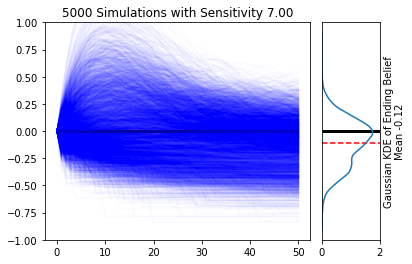

In [22]:
n_sims = 5000
S = 7
ends = []
plt.subplot2grid((1,5), (0,0), 1, 4)
for _ in range(n_sims):
    res = sim(steps=50, sensitivity=S)
    ends.append(res[-1])
    plt.plot(res, 'b', alpha=.02)
plt.title('%i Simulations with Sensitivity %.02f' % (n_sims, S))
plt.hlines(0, 0, 50, 'k', linewidth=3, alpha=1)
plt.ylim(-1, 1)

ax = plt.subplot2grid((1,5), (0,4), 1, 1)
density = gaussian_kde(ends)
xs = np.linspace(-1,1,200)
plt.plot(density(xs), xs)
plt.hlines(0,2,0, 'k', linewidth=3, alpha=1)
plt.hlines(np.mean(ends), 0, 2, 'r', linestyles='dashed')
plt.yticks([]);
plt.xlim(0,2)
plt.ylabel('Gaussian KDE of Ending Belief\nMean %.02f' % np.mean(ends))
ax.yaxis.set_label_position("right")

# As a function of forcing

In [82]:
n_sims = 100000

estimates = []
rs = np.linspace(0,1,20)
for r in rs:
    estimates.append(np.mean([sim(steps=10, weight=.5, forcing=r)[-1] for _ in range(n_sims)]))

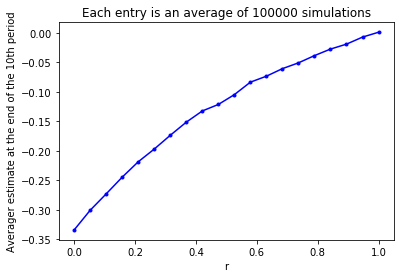

In [87]:
plt.plot(rs, estimates, 'b.-')
plt.xlabel('r')
plt.ylabel('Averager estimate at the end of the 10th period')
plt.title('Each entry is an average of %i simulations' % n_sims);